In [10]:
import os
import glob
import numpy as np
import networkx as nx
from networkx.drawing.nx_agraph import read_dot, write_dot, graphviz_layout

In [ ]:
path = "/Users/christopher/Uni/MasterThesis/resultsvm"

In [ ]:
files = glob.glob(path + "/cpu/*")

In [ ]:
# Convert files to dot files for further analysis
for file in files:
    name = file.split(".")[0]
    command = f"go tool pprof -nodecount=3000 --nodefraction=0.0 --edgefraction=0.0 -dot {name}.out > {name}.dot"
    stream = os.popen(command)
    output = stream.read()

In [ ]:
dotFiles = glob.glob(path + "/cpu/*.dot")

In [ ]:
# Plot all graphs in the same layout
plt.figure(figsize=(20, 100), dpi=80)
for dotFile in dotFiles:
    graph = read_dot(dotFile)
    graph = convertWeigthsToFloat(graph)
    pos = graphviz_layout(graph, prog='dot')
    nx.draw(graph, pos, with_labels=False, arrows=True)
    plt.show()

# Read from Sqlite Database

In [1]:
import sqlite3

In [2]:
db_path = "/Users/christopher/Uni/MasterThesis/experiment_4_roaring/stopped_exp.db"

('sqlite_sequence',)
('project',)
('benchmark',)
('measurement',)

In [6]:
# Create a SQL connection to our SQLite database
con = sqlite3.connect(db_path)

cur = con.cursor()

res = cur.execute('SELECT * FROM measurement;')
names = list(map(lambda x: x[0], res.description))

# The result of a "cursor.execute" can be iterated over by row
for row in res:
    name = row[-1]

    try:
        results[name]
    except KeyError:
      results[name] = []

    results[name] = row

# Be sure to close the connection
con.close()

In [7]:
results

{'v1.3.0': (1886,
  1000000000,
  6e-07,
  1,
  5,
  3,
  3,
  1,
  3,
  1,
  35,
  'BenchmarkChecksum/checksum-32',
  'v1.3.0')}

In [8]:
str(names)

"['m_id', 'n', 'ns_per_op', 'bed_setup', 'it_setup', 'sr_setup', 'ir_setup', 'bed_pos', 'it_pos', 'sr_pos', 'ir_pos', 'b_name', 'tag']"

# Algorithm

In [11]:
import glob
import itertools
from operator import itemgetter

import numpy as np
import matplotlib.pyplot as plt
import networkx as nx
from networkx.classes.multidigraph import MultiDiGraph
from networkx.drawing.nx_agraph import read_dot, write_dot, graphviz_layout

import stats
import graphs
import sqlite_helper as helper

In [12]:
import importlib
importlib.reload(helper)
importlib.reload(stats)
importlib.reload(graphs)

<module 'graphs' from '/Users/christopher/Uni/MasterThesis/repositories/masters-thesis/src/graphs.py'>

In [100]:
db_path = "/Users/christopher/Uni/MasterThesis/resultsvm/sqlite-database.db"
dot_path = "/Users/christopher/Uni/MasterThesis/resultsvm"

# Get all dot files
dot_files = glob.glob(dot_path + "/cpu/*.dot")

In [118]:
def get_name_from_dot(path):
    return path.split("/")[-1].split(".")[0].split("_")[0]

In [ ]:
# Read out none perforamnce benchmarks
none_perf_benchs = []
for dot_file in dot_files:
    name = get_name_from_dot(dot_file)
    if "size" in name or "memory" in name:
        none_perf_benchs.append(name)
        print(name)
print(len(none_perf_benchs))

In [102]:
"""Load and convert all graphs, and generate a unique node mapping."""
all_graphs = []

for dotFile in dot_files:
    c_graph = read_dot(dotFile)
    c_graph = graphs.convertWeigthsToFloat(c_graph)
    
    # Removing starting nodes
    try:
        c_graph.remove_node("File: model.test")
    except:
        pass

    try:
        c_graph.remove_node("File: expfmt.test")
    except:
        pass

    all_graphs.append(c_graph)

nameMappingFull = graphs.generateUniqueNodeMapping(all_graphs)

In [104]:
"""Convert all graphs using the new node mapping."""
new_graphs=[]
for graph in all_graphs:
    mapping = graphs.getNodeNameMapping(graph)
    nodeMapping = {}
    # get node name by value
    for key in mapping:
        nodeMapping[key] = nameMappingFull[mapping[key]]

    new_graphs.append(nx.relabel_nodes(graph, nodeMapping))

In [105]:
""" Generate full graph, position and labels."""
labeldict = {v: k for k, v in nameMappingFull.items()}
full_graph = nx.compose_all(new_graphs)
pos_full = graphviz_layout(full_graph, prog='dot')

### Read measurements

In [109]:
measurements = helper.get_all_measurements(db_path)
measurements = helper.group_measurements_by_name(measurements, -1)

In [110]:
measurements.keys()

dict_keys(['BenchmarkParseText', 'BenchmarkParseTextGzip', 'BenchmarkParseProto', 'BenchmarkParseProtoGzip', 'BenchmarkParseProtoMap', 'BenchmarkDiscriminatorHTTPHeader', 'BenchmarkOpenMetricsCreate', 'BenchmarkCreate', 'BenchmarkCreateBuildInfo', 'BenchmarkTextParse', 'BenchmarkParseError', 'BenchmarkLabelNames', 'BenchmarkLabelValues', 'BenchmarkMetric', 'BenchmarkLabelToSignatureScalar', 'BenchmarkLabelToSignatureSingle', 'BenchmarkLabelToSignatureDouble', 'BenchmarkLabelToSignatureTriple', 'BenchmarkMetricToFingerprintScalar', 'BenchmarkMetricToFingerprintSingle', 'BenchmarkMetricToFingerprintDouble', 'BenchmarkMetricToFingerprintTriple', 'BenchmarkMetricToFastFingerprintScalar', 'BenchmarkMetricToFastFingerprintSingle', 'BenchmarkMetricToFastFingerprintDouble', 'BenchmarkMetricToFastFingerprintTriple', 'BenchmarkEmptyLabelSignature', 'BenchmarkMetricToFastFingerprintTripleConc1', 'BenchmarkMetricToFastFingerprintTripleConc2', 'BenchmarkMetricToFastFingerprintTripleConc4', 'Benchma

In [111]:
stability_measurements = {}
for bench in measurements.keys():
    x = []
    for entry in measurements[bench]:
        x.append(entry[2])

    stability_measurements[bench] = stats.cv(x)
    # stability_measurements[bench] = stats.max_spread(x)

### Calculate Reduced Suite

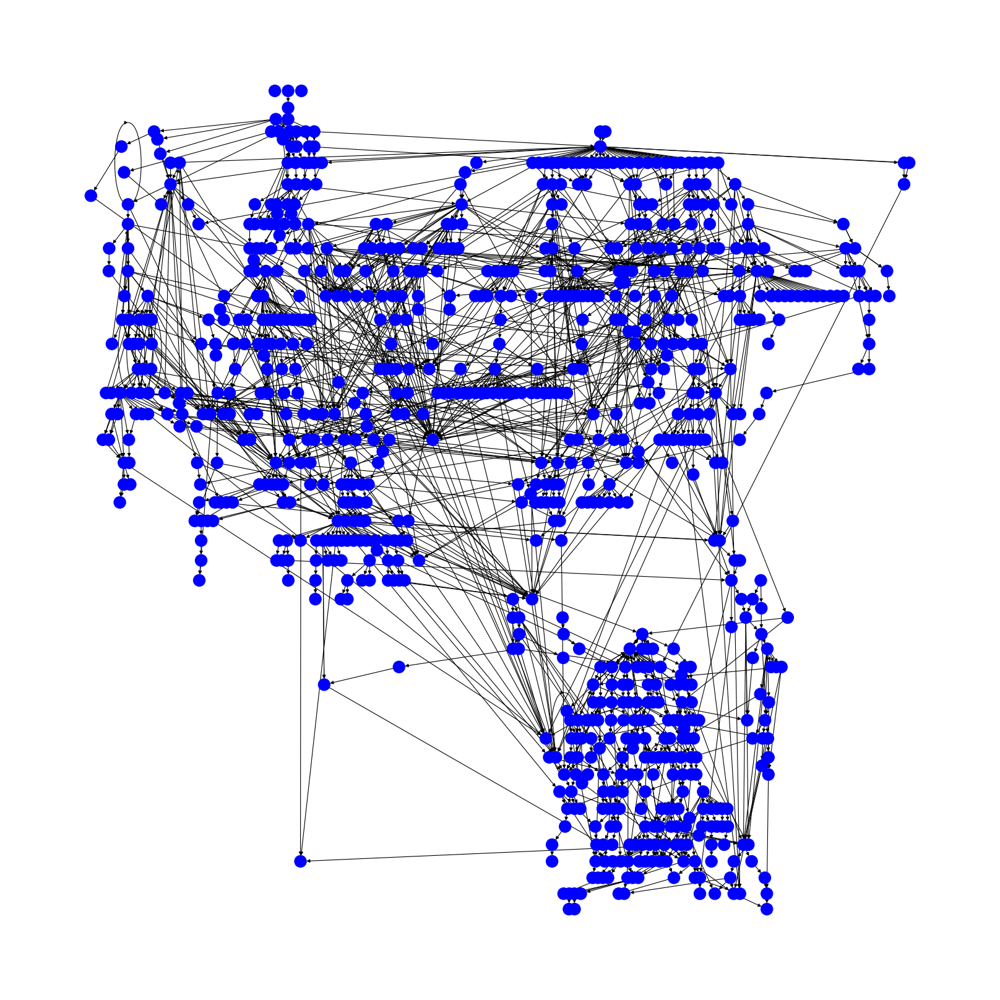

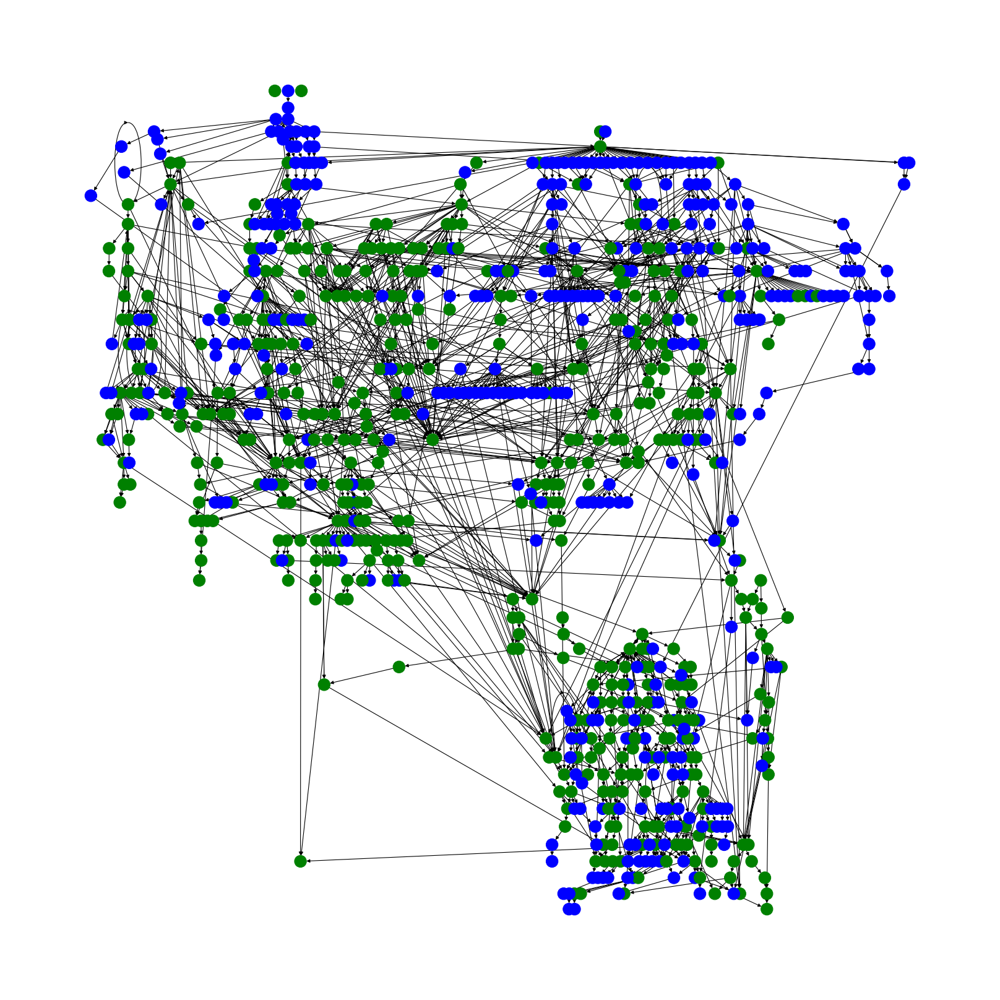

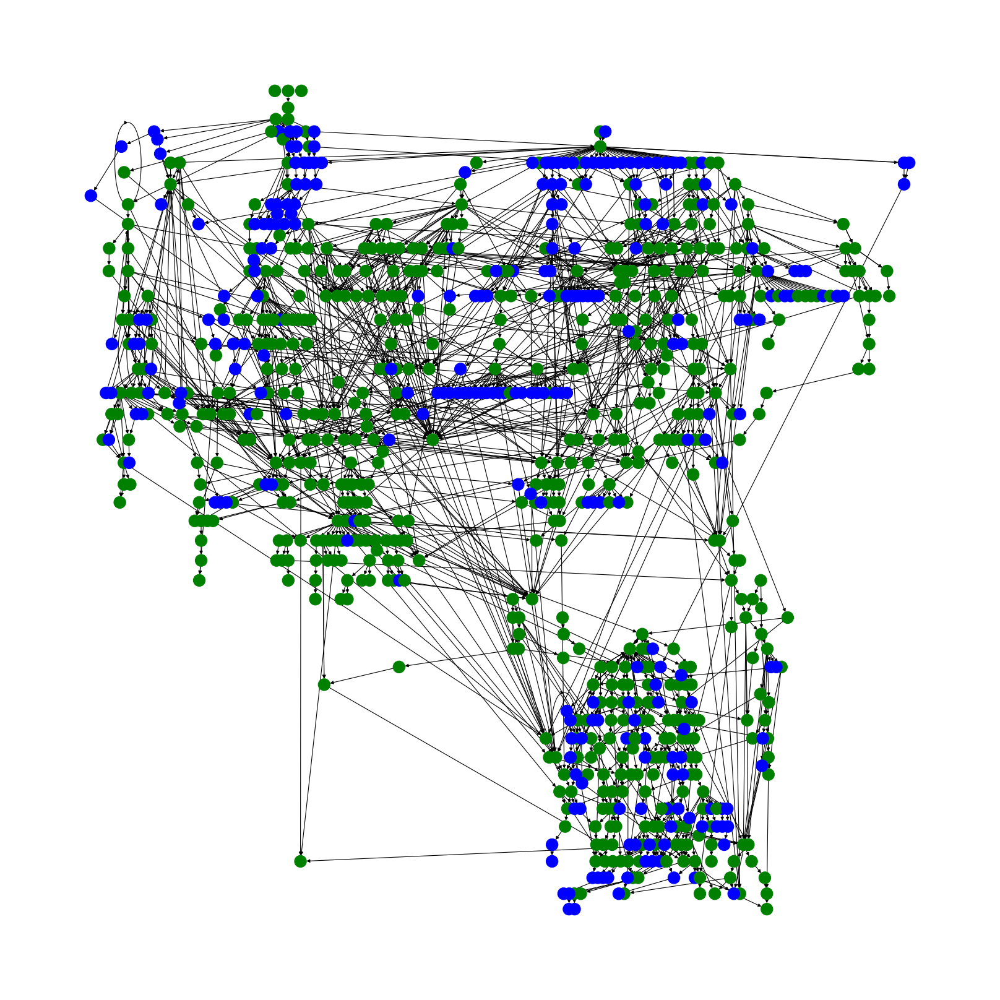

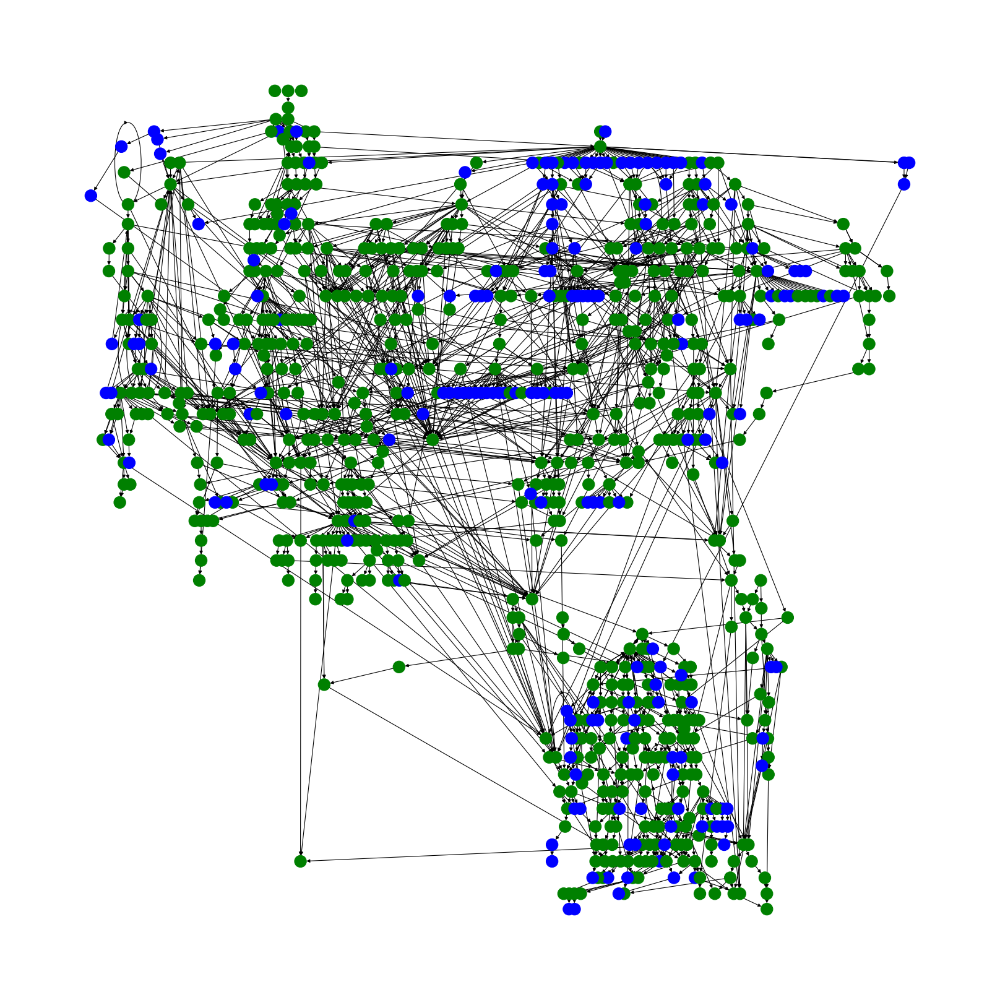

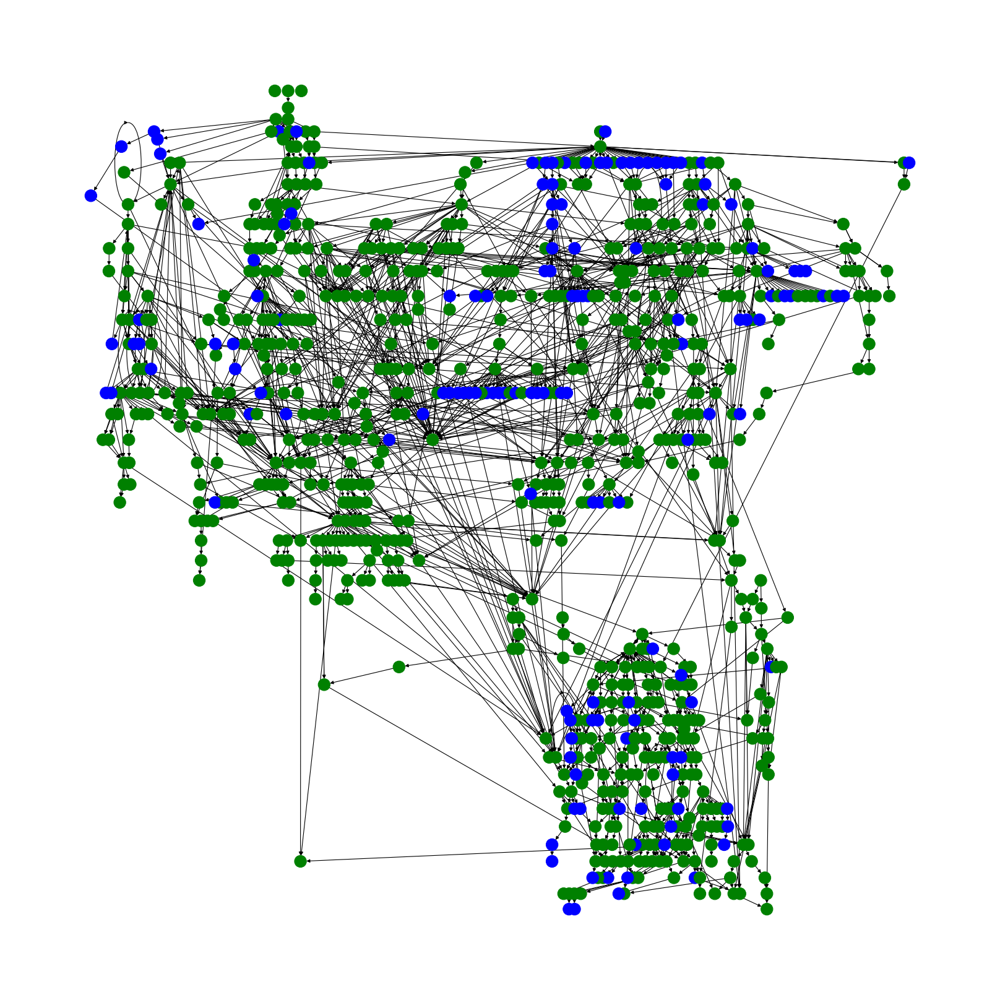

...

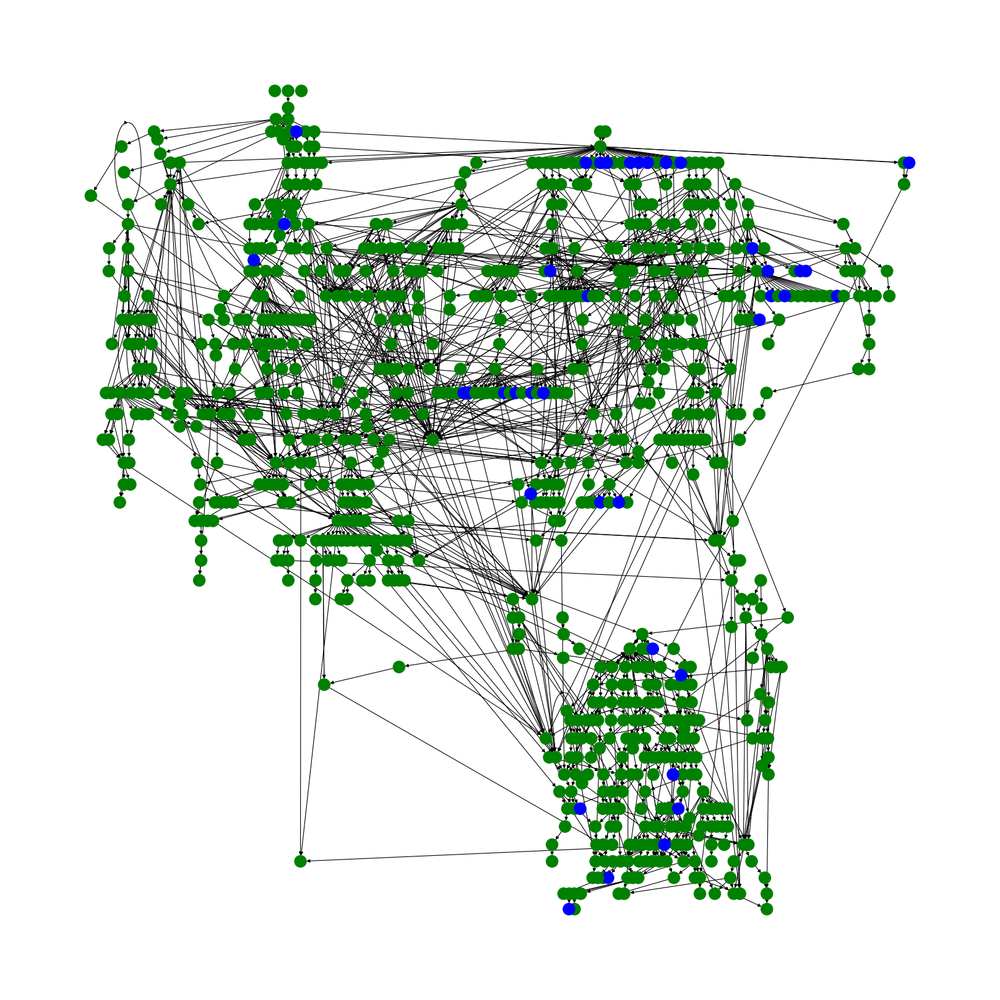

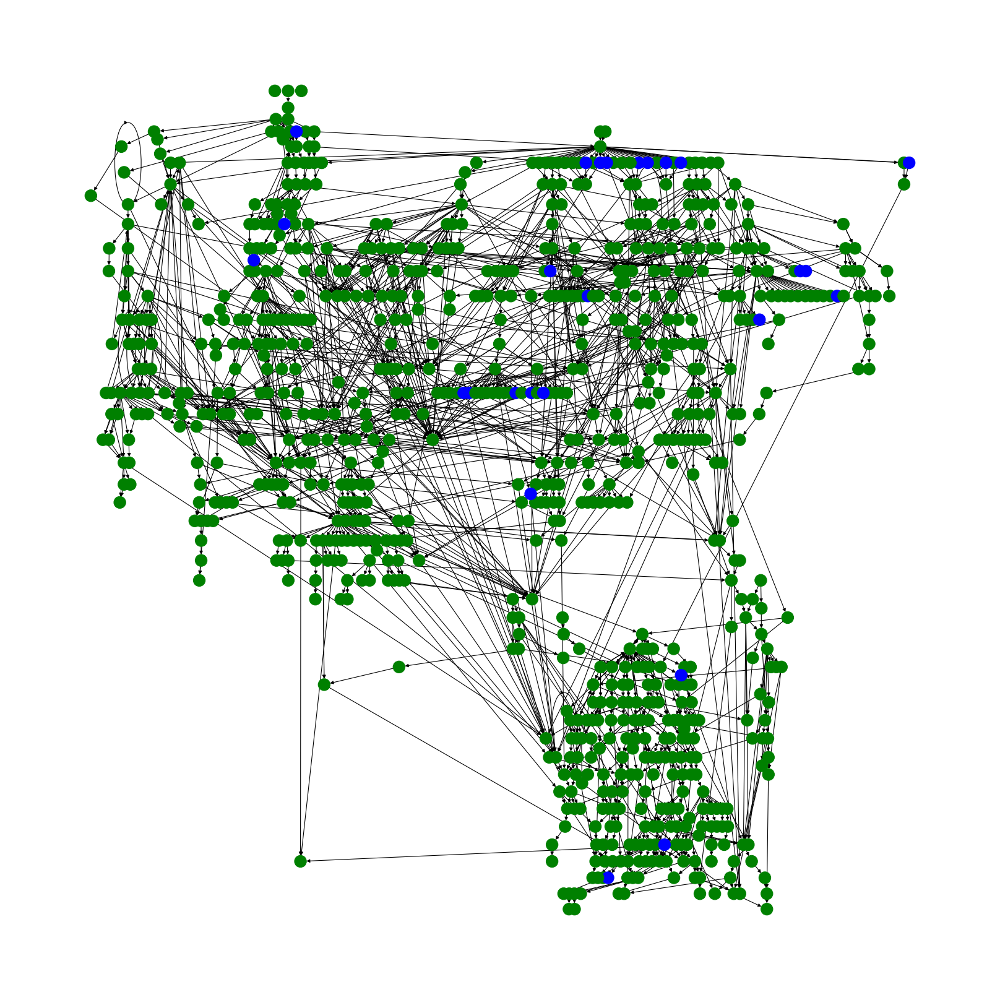

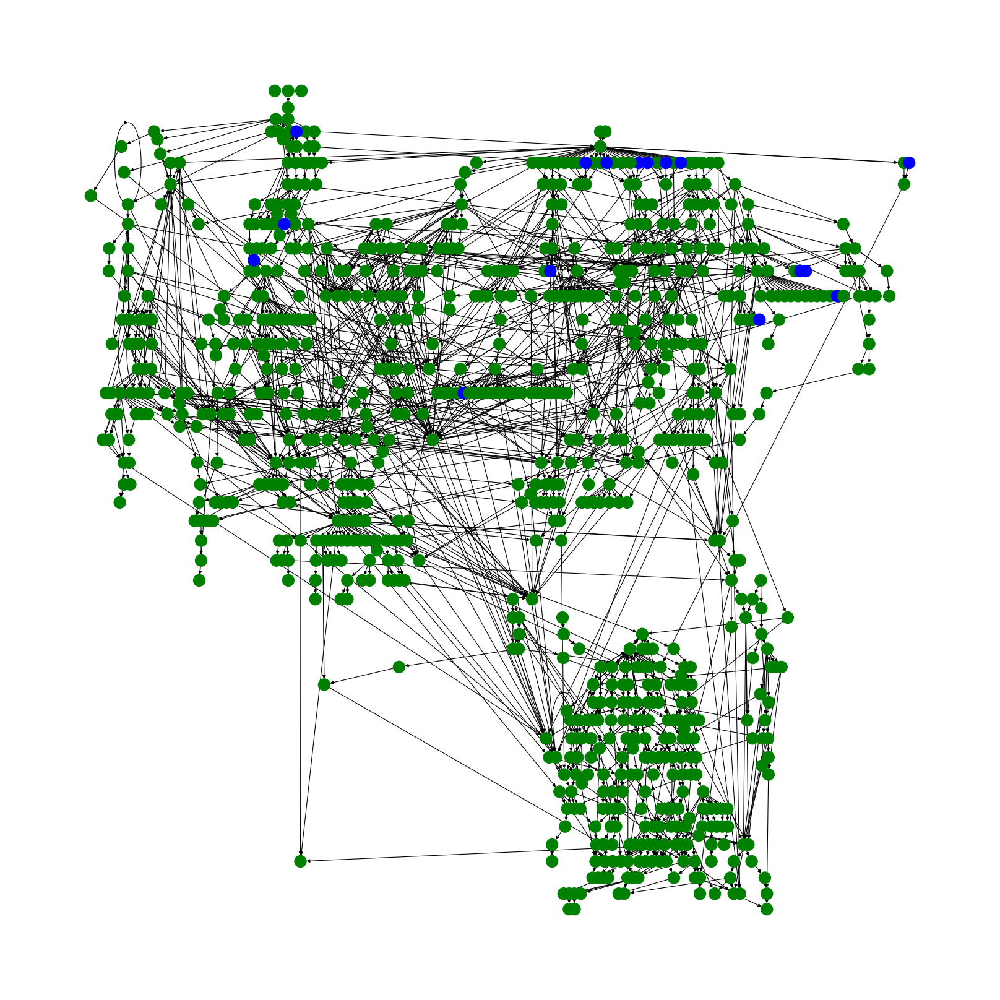

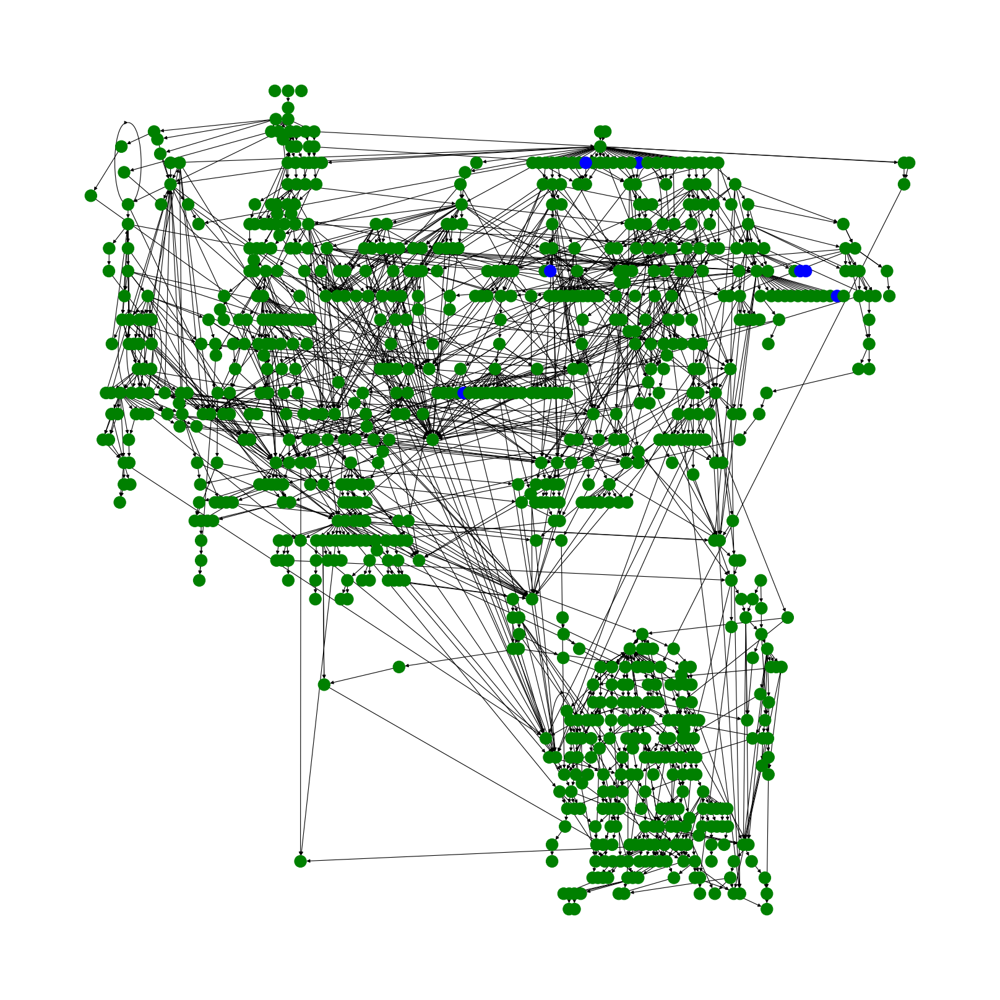

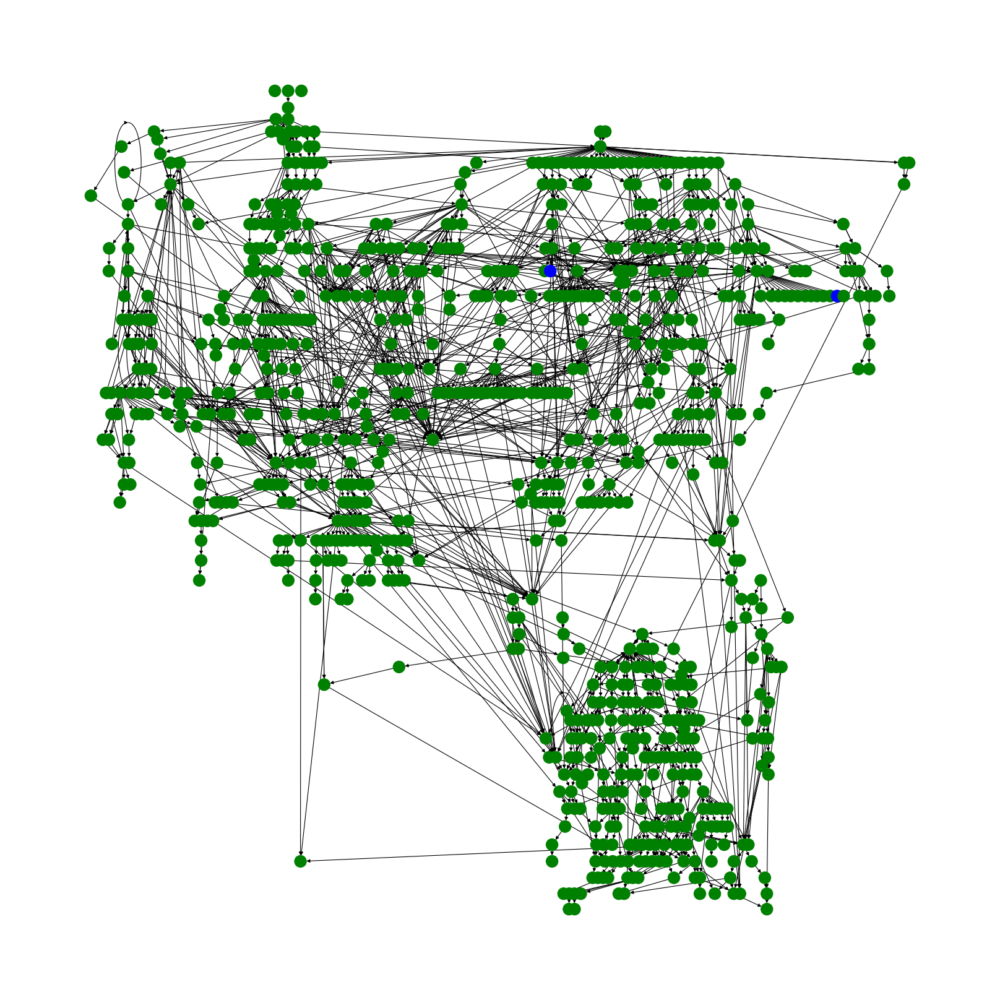

In [77]:
"""Take graphs with highest coverage and remove them from the remaining graphs."""
reduce_graphs = []
highest_coverage: tuple = (0, 0)
remaining_graph = full_graph.copy()
iterations = 0

while len(remaining_graph.nodes()) > 1:
    # get graph with highest coverage
    highest_coverage = (0, 0)
    coverages = []
    for idx, g in enumerate(new_graphs):
        # get overlap with full graph
        overlap_nodes = np.intersect1d(list(g.nodes()), list(remaining_graph.nodes()))
        overlap = len(overlap_nodes)

        if overlap == highest_coverage[1] and overlap > 0:
            #print(f"Remaining: {len(remaining_graph.nodes())} - Overlap between {idx} and {highest_coverage[0]}: {overlap}")
            pass

        if overlap > highest_coverage[1]:
            highest_coverage = (idx, overlap)

        coverages.append((idx, overlap))
    covs = sorted(coverages, key=itemgetter(1), reverse=True)
    if covs[0][1] == covs[1][1] and False:
        color_map1 = ['darkred' if node in remaining_graph.nodes()  else 'red' for node in new_graphs[covs[0][0]].nodes()]
        color_map2 = ['darkblue' if node in remaining_graph.nodes()  else 'blue' for node in new_graphs[covs[1][0]].nodes()]
        g1 = new_graphs[covs[0][0]]
        g2 = new_graphs[covs[1][0]]
        print(f"Remaining: {len(remaining_graph.nodes())} - {covs[:3]}")
        print(f"Files: {dot_files[covs[0][0]]} and {dot_files[covs[1][0]]}")
        graphs.drawDiffernce(g1, g2, pos_full, labeldict, color_map=[color_map1, color_map2])

    if iterations % 5  == 0:
        plt.figure(figsize=(20, 20), dpi=80)
        color_map_full = ['blue' if node in remaining_graph.nodes()  else 'green' for node in full_graph.nodes()]
        nx.draw(full_graph, pos_full, with_labels=False, arrows=True, node_color=color_map_full)
        plt.show()

    iterations += 1
    
    reduce_graphs.append(highest_coverage)
    remaining_graph.remove_nodes_from(new_graphs[highest_coverage[0]].nodes())


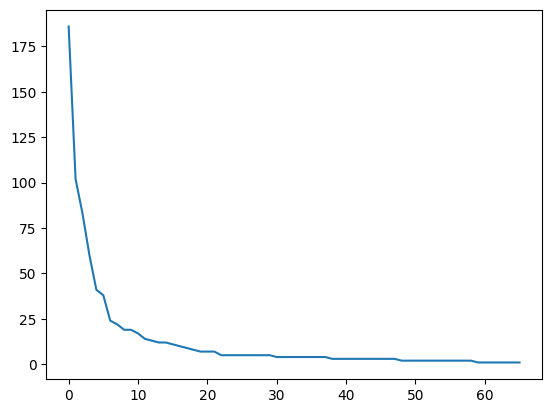

In [76]:
plt.plot([x[1] for x in reduce_graphs])
plt.show()

In [133]:
# cantor pairing function
def cantor(a, b):
    return 0.5 * (a+b) * (a+b+1) + b

In [166]:
stability_measurements

{'BenchmarkParseText': 0.01215710796425764,
 'BenchmarkParseTextGzip': 0.012334867948025416,
 'BenchmarkParseProto': 0.026252071809763015,
 'BenchmarkParseProtoGzip': 0.026162654179290656,
 'BenchmarkParseProtoMap': 0.015083729686142558,
 'BenchmarkDiscriminatorHTTPHeader': 0.011189155289500359,
 'BenchmarkOpenMetricsCreate': 0.008776815135796784,
 'BenchmarkCreate': 0.007875177088860348,
 'BenchmarkCreateBuildInfo': 0.001986784906574863,
 'BenchmarkTextParse': 0.012620818131999377,
 'BenchmarkParseError': 0.02155226454716525,
 'BenchmarkLabelNames': 0.016727704331437773,
 'BenchmarkLabelValues': 0.02581247016980098,
 'BenchmarkMetric': 0.004980113675053011,
 'BenchmarkLabelToSignatureScalar': 0.001549530123151584,
 'BenchmarkLabelToSignatureSingle': 0.013703202219869298,
 'BenchmarkLabelToSignatureDouble': 0.009393439289322108,
 'BenchmarkLabelToSignatureTriple': 0.007604383152695279,
 'BenchmarkMetricToFingerprintScalar': 0.002230890621108421,
 'BenchmarkMetricToFingerprintSingle': 0

[(67, 73.33333333333333, 'BenchmarkMetricToFastFingerprintTripleConc8', 'BenchmarkMetricToFastFingerprintTripleConc1'), (73, 60.0, 'BenchmarkMetricToFastFingerprintTripleConc8', 'BenchmarkMetricToFastFingerprintTripleConc1'), (98, 73.33333333333333, 'BenchmarkMetricToFastFingerprintTripleConc8', 'BenchmarkMetricToFastFingerprintTripleConc2')]
0 of 4752


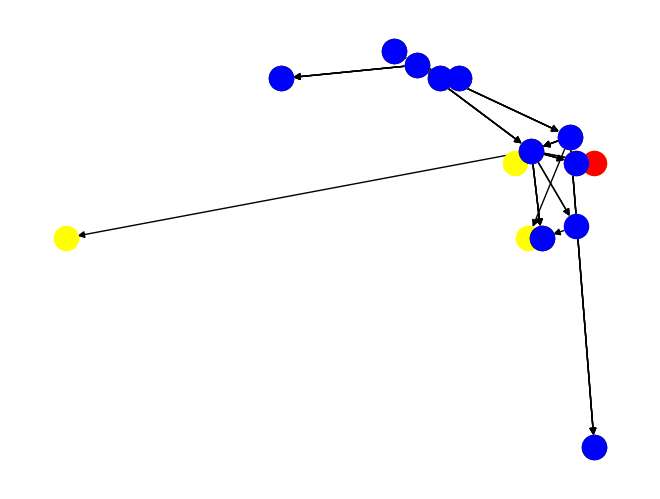

In [151]:
ap = {}
count = 0
total = 0
for idx1, g1 in enumerate(new_graphs):
    shadowed_graphs = []
    for idx2, g2 in enumerate(new_graphs):

        n1 = get_name_from_dot(dot_files[idx1])
        n2 = get_name_from_dot(dot_files[idx2])

        if n1 == n2:
            continue

        if f"{idx1}-{idx2}" in ap.keys() or f"{idx2}-{idx1}" in ap.keys():
            continue

        if idx1 == idx2:
            continue

        if len(list(g1.nodes())) == 0 or len(list(g2.nodes())) == 0:
            continue

        total += 1 

        overlap = np.intersect1d(list(g1.nodes()), list(g2.nodes()))
        p1 = (len(overlap)/len(list(g1.nodes()))) * 100
        p2 = (len(overlap)/len(list(g2.nodes()))) * 100

        if p2 == 100:
            shadowed_graphs.append((idx2, p1, n1, n2))

        if p1 == 100 == p2:
            count += 1
            print(f"Stability for {n1}: {stability_measurements[n1]} (red)")
            print(f"Stability for {n2}: {stability_measurements[n2]} (blue)")
            graphs.drawDiffernce(g1, g2, pos_full, labels=labeldict, shift=40)

        if ((p1 >=100.0 and p2 >= 60.0) or (p1 >= 60.0 and p2 >= 100.0)) and len(overlap) > 2:
            pass
            #print(f"Overlap between {idx1} and {idx2}: {p1} {p2}")
            #print(f"Stability for 1: {stability_measurements[n1]} (red)")
            #print(f"Stability for 2: {stability_measurements[n2]} (blue)")
            #graphs.drawDiffernce(g1, g2, pos_full, labels=labeldict, shift=40)
            #count += 1

        ap[f"{idx1}-{idx2}"] = True
        ap[f"{idx2}-{idx1}"] = True
    
    if len(shadowed_graphs) > 2:
        nx.draw(new_graphs[idx1], pos_full, with_labels=False, arrows=True, node_color='yellow')
        nx.draw(new_graphs[shadowed_graphs[0][0]], pos_full, with_labels=False, arrows=True, node_color='red')
        nx.draw(new_graphs[shadowed_graphs[1][0]], pos_full, with_labels=False, arrows=True, node_color='green')
        nx.draw(new_graphs[shadowed_graphs[2][0]], pos_full, with_labels=False, arrows=True, node_color='blue')
        print(shadowed_graphs)

print(f"{count} of {total}")


In [163]:
ap = {}
count = 0
total = 0
for idx1, g1 in enumerate(new_graphs):
    highest_coverage: tuple = (0, 0)
    remaining_graph = g1.copy()
    covering_graphs = []
    
    iterations = 0
    while len(remaining_graph.nodes()) > 1 and iterations < 20:
        # get graph with highest coverage
        highest_coverage = (0, 0)
        coverages = []
        for idx, g in enumerate(new_graphs):

            if idx == idx1:
                continue
            
            # get overlap with full graph
            overlap_nodes = np.intersect1d(list(g.nodes()), list(remaining_graph.nodes()))
            overlap = len(overlap_nodes)

            if overlap == highest_coverage[1] and overlap > 0:
                #print(f"Remaining: {len(remaining_graph.nodes())} - Overlap between {idx} and {highest_coverage[0]}: {overlap}")
                pass

            if overlap > highest_coverage[1]:
                name = get_name_from_dot(dot_files[idx])
                highest_coverage = (idx, overlap, stability_measurements[name])
                coverages.append((idx, overlap))
        
        covs = sorted(coverages, key=itemgetter(1), reverse=True)
        
        if highest_coverage != (0,0):
            covering_graphs.append(highest_coverage)
        
        remaining_graph.remove_nodes_from(new_graphs[highest_coverage[0]].nodes())
        iterations += 1
    
    # print(f"{len(g1.nodes())}: {covs}")
    
    if len(covering_graphs) > 1:
        name = get_name_from_dot(dot_files[idx1])
        print(f"{name} - {stability_measurements[name]} - {len(g1.nodes())}:  {covering_graphs}")



BenchmarkOpenMetricsCreate - 0.008776815135796784 - 44:  [(11, 37, 0.008776815135796784), (74, 4, 0.007875177088860348), (63, 1, 0.01215710796425764)]
BenchmarkTextParse - 0.012620818131999377 - 155:  [(10, 118, 0.012620818131999377), (62, 15, 0.02155226454716525), (8, 8, 0.012620818131999377), (32, 5, 0.006862325525826269), (5, 2, 0.012334867948025416), (71, 2, 0.02581247016980098)]
BenchmarkParseTextGzip - 0.012334867948025416 - 167:  [(7, 103, 0.012334867948025416), (24, 25, 0.015083729686142558), (10, 11, 0.012620818131999377), (94, 5, 0.011189155289500359), (29, 3, 0.015083729686142558), (34, 3, 0.026162654179290656), (37, 2, 0.016727704331437773), (81, 2, 0.001986784906574863), (5, 1, 0.012334867948025416), (16, 1, 0.026252071809763015), (19, 1, 0.026252071809763015), (69, 1, 0.007875177088860348)]
BenchmarkJSONMarshallingSampleHistogramPairMatrix - 0.0025893769958764703 - 152:  [(9, 113, 0.0025893769958764703), (4, 18, 0.0025893769958764703), (65, 10, 0.02155226454716525), (32, 

In [134]:
np.asarray/[1,3].join("-")

AttributeError: 'list' object has no attribute 'join'

In [38]:
"""Take graphs with highest coverage and remove them from the remaining graphs."""
reduce_graphs = []
highest_coverage: tuple = (0, 0)
remaining_graph = full_graph.copy()
iterations = 0

while len(remaining_graph.nodes()) > 1:
    # get graph with highest coverage
    highest_coverage = (0, 0)
    coverages = []
    for idx, g in enumerate(new_graphs):
        # get overlap with full graph
        overlap_nodes = np.intersect1d(list(g.nodes()), list(remaining_graph.nodes()))
        overlap = len(overlap_nodes)

        if overlap == highest_coverage[1] and overlap > 0:
            #print(f"Remaining: {len(remaining_graph.nodes())} - Overlap between {idx} and {highest_coverage[0]}: {overlap}")
            pass

        if overlap > highest_coverage[1]:
            highest_coverage = (idx, overlap)

        coverages.append((idx, overlap))
    covs = sorted(coverages, key=itemgetter(1), reverse=True)
    if covs[0][1] == covs[1][1] and False:
        color_map1 = ['darkred' if node in remaining_graph.nodes()  else 'red' for node in new_graphs[covs[0][0]].nodes()]
        color_map2 = ['darkblue' if node in remaining_graph.nodes()  else 'blue' for node in new_graphs[covs[1][0]].nodes()]
        g1 = new_graphs[covs[0][0]]
        g2 = new_graphs[covs[1][0]]
        print(f"Remaining: {len(remaining_graph.nodes())} - {covs[:3]}")
        print(f"Files: {dot_files[covs[0][0]]} and {dot_files[covs[1][0]]}")
        graphs.drawDiffernce(g1, g2, pos_full, labeldict, color_map=[color_map1, color_map2])

    if iterations % 5  == 0:
        plt.figure(figsize=(20, 20), dpi=80)
        color_map_full = ['blue' if node in remaining_graph.nodes()  else 'green' for node in full_graph.nodes()]
        nx.draw(full_graph, pos_full, with_labels=False, arrows=True, node_color=color_map_full)
        plt.show()

    iterations += 1
    
    reduce_graphs.append(highest_coverage)
    remaining_graph.remove_nodes_from(new_graphs[highest_coverage[0]].nodes())


NodeView(('N788',))

In [164]:
labeldict

{'N1': 'expfmt-writeOpenMetricsSample',
 'N2': 'expfmt-writeOpenMetricsLabelPairs',
 'N3': 'testing-(*B)-launch',
 'N4': 'expfmt-writeOpenMetricsFloat',
 'N5': 'bytes-(*Buffer)-WriteString',
 'N6': 'strings-(*byteStringReplacer)-WriteString',
 'N7': 'runtime-memmove',
 'N8': 'strconv-genericFtoa',
 'N9': 'expfmt-writeEscapedString',
 'N10': 'expfmt-MetricFamilyToOpenMetrics',
 'N11': 'bytes-(*Buffer)-Write',
 'N12': 'expfmt-writeUint',
 'N13': 'strconv-ryuFtoaShortest',
 'N14': 'bytes-(*Buffer)-tryGrowByReslice',
 'N15': 'runtime-getitab',
 'N16': 'bytes-(*Buffer)-WriteByte',
 'N17': 'bytes-IndexAny',
 'N18': 'strconv-ryuDigits',
 'N19': 'sync-(*Pool)-pin',
 'N20': 'strconv-ryuDigits32',
 'N21': 'sync-(*Pool)-Get',
 'N22': 'strings-(*Replacer)-WriteString',
 'N23': 'strconv-fmtE',
 'N24': 'indexbytebody-0.03s (2.42%)',
 'N25': 'sync-(*Pool)-Put',
 'N26': 'runtime-convI2I',
 'N27': 'runtime-assertI2I2',
 'N28': 'go-(*Bucket)-GetUpperBound',
 'N29': 'strconv-formatBits',
 'N30': 'go-(*Hi

16


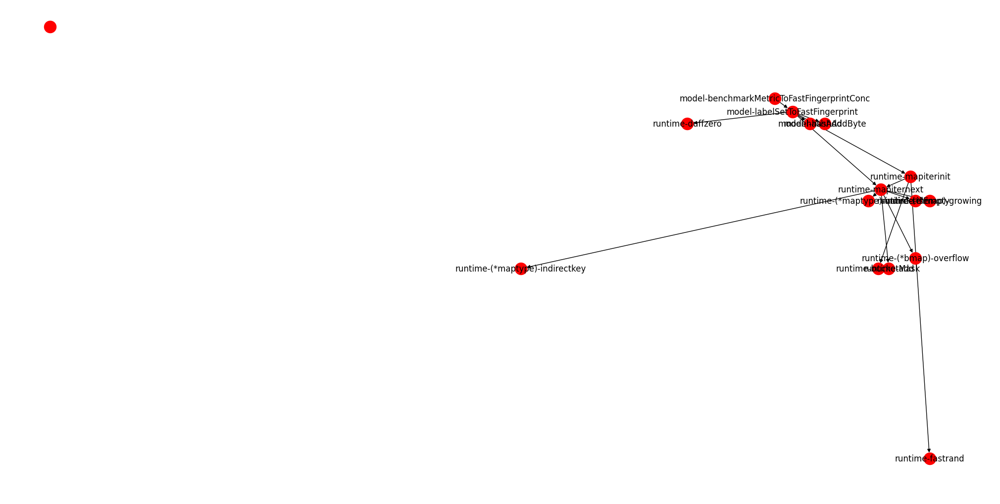

In [27]:
g1 = new_graphs[15]
print(len(g1.nodes()))
plt.figure(figsize=(20, 10))
labels = dict((k, labeldict[k]) for k in list(g1.nodes())[1:])
nx.draw(g1, pos_full, with_labels=True, labels=labels, arrows=True, node_color='red')

In [11]:
print(f"{len(reduce_graphs)} of {len(new_graphs)} benchmarks")

66 of 102 benchmarks


In [12]:
reduced_full_graph = nx.compose_all([new_graphs[x[0]] for x in reduce_graphs])
reduced_pos_full = graphviz_layout(reduced_full_graph, prog='dot')

KeyError: 'N788'

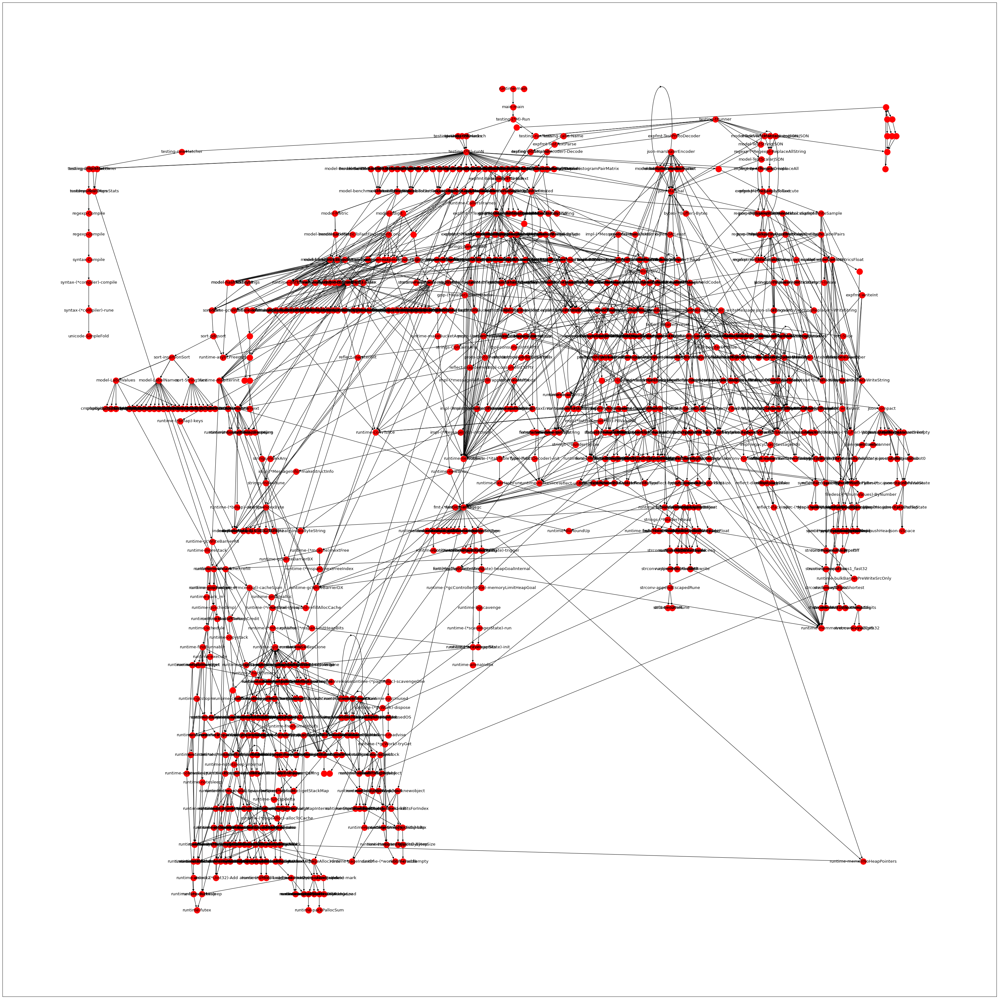

In [13]:
plt.figure(figsize=(40, 40), dpi=80)
nx.draw(reduced_full_graph, reduced_pos_full, with_labels=True, labels=labeldict, arrows=True, node_color='red')

# Read and process graphs

In [ ]:
dot_files = glob.glob(dot_path + "/cpu/*.dot")

In [ ]:
# check for files containing string
for idx, file in enumerate(dot_files):
    if "FingerprintScalar" in file:
        print(f"Found file at index {idx}: {file}")

In [ ]:
print(dot_files[-10])
print(dot_files[-3])

In [ ]:
graph1 = graphs.loadGraphFromDot(dot_files[99])
graph2 = graphs.loadGraphFromDot(dot_files[92])
graph3 = graphs.loadGraphFromDot(dot_files[90])

In [ ]:
print(graph1.nodes(data=False))
print(graph2.nodes(data=False))
print(graph3.nodes(data=False))

In [ ]:
pos1 = graphviz_layout(graph1, prog='dot')
print(pos1)

pos2 = graphviz_layout(graph2, prog='dot')
print(pos2)

In [ ]:
plt.figure(figsize=(20, 10), dpi=80)
pos1 = graphviz_layout(graph1, prog='dot')
pos2 = graphviz_layout(graph2, prog='dot')
pos3 = graphviz_layout(graph3, prog='dot')
nx.draw(graph1, pos1, with_labels=False, arrows=True, node_color='red')
nx.draw(graph2, pos2, with_labels=False, arrows=True, node_color='green')
nx.draw(graph3, pos3, with_labels=False, arrows=True, node_color='black')

In [ ]:
graphs.drawDiffernce(graph2, graph1)

In [ ]:
for node in graph1.nodes(data=True):
    print(node[1]["label"].split("\\n"))
    print(node)
    break

In [ ]:
for node in graph2.nodes(data=True):
    print(node[1]["label"].split("\\n"))

In [ ]:
all_graphs = [graph1, graph2, graph3]
nameMapping = graphs.generateUniqueNodeMapping(all_graphs)

In [ ]:
nameMapping

In [ ]:
new_graphs=[]
for graph in all_graphs:
    mapping = graphs.getNodeNameMapping(graph)
    nodeMapping = {}
    # get node name by value
    for key in mapping:
        nodeMapping[key] = nameMapping[mapping[key]]

    new_graphs.append(nx.relabel_nodes(graph, nodeMapping))

In [ ]:
print(dot_files[12])
print(dot_files[3])

In [ ]:
count = 0
for idx1, g1 in enumerate(new_graphs):
    for idx2, g2 in enumerate(new_graphs):
        if idx1 == idx2:
            continue
        overlap = np.intersect1d(list(g1.nodes()), list(g2.nodes()))
        perc1 = (len(overlap)/len(list(g1.nodes()))) * 100
        perc2 = (len(overlap)/len(list(g2.nodes()))) * 100

        if perc1 >= 80.0 and perc2 >= 80.0:
            print(f"Overlap between {idx1} and {idx2}: {perc1} {perc2}")
            count += 1

            graphs.drawDiffernce(g1, g2, pos_full, labels=labeldict, shift=1500)
            sys.exit(0)
print(f"{count} of {len(new_graphs)**2}")

In [ ]:
labeldict = {v: k for k, v in nameMapping.items()}
colors = ['red', 'green', 'blue']
plt.figure(figsize=(20, 10), dpi=80)
pos = graphviz_layout(nx.compose_all(new_graphs), prog='dot')

for graph in new_graphs[:3]:

    print(graph.nodes(data=False))
    for k,v in pos.items():
        pos[k] = (v[0] + 10, v[1]+ 100)
        pass

    nx.draw(graph, pos, labels=labeldict, with_labels=True, arrows=True, node_color=colors.pop())

In [ ]:
list(graph.nodes())[1:]

In [ ]:
graphs.getNodeNameMapping(graph1)

In [ ]:
all_graphs = []

for dotFile in dot_files:
    c_graph = read_dot(dotFile)
    c_graph = graphs.convertWeigthsToFloat(c_graph)
    all_graphs.append(c_graph)

nameMappingFull = graphs.generateUniqueNodeMapping(all_graphs)

In [ ]:
new_graphs=[]
for graph in all_graphs:
    mapping = graphs.getNodeNameMapping(graph)
    nodeMapping = {}
    # get node name by value
    for key in mapping:
        nodeMapping[key] = nameMappingFull[mapping[key]]

    new_graphs.append(nx.relabel_nodes(graph, nodeMapping))

In [ ]:
labeldict = {v: k for k, v in nameMappingFull.items()}
full_graph = nx.compose_all(new_graphs)
pos_full = graphviz_layout(full_graph, prog='dot')

In [ ]:
plt.figure(figsize=(40, 40), dpi=80)
nx.draw(full_graph, pos_full, with_labels=True, labels=labeldict, arrows=True, node_color='red')

In [ ]:
for g in new_graphs[0:5]:
    plt.figure(figsize=(20, 10), dpi=80)
    nx.draw(g, pos_full, with_labels=True, labels=labeldict, arrows=True, node_color='red')
    plt.show()

In [ ]:
full_graph.nodes()

In [ ]:
len(full_graph.nodes())

In [ ]:

# take new graph with highest coverage
reduce_graphs = []
highest_coverage: tuple = (0, 0)
remaining_graph = full_graph

while len(remaining_graph.nodes()) > 1:
    # get graph with highest coverage
    highest_coverage = (0, 0)
    for idx, g in enumerate(new_graphs):
        # get overlap with full graph
        overlap = len(np.intersect1d(list(g.nodes()), list(remaining_graph.nodes())))

        if overlap == highest_coverage[1]:
            print(f"Overlap between {idx} and {highest_coverage[0]}: {overlap}")

        if overlap > highest_coverage[1]:
            highest_coverage = (idx, overlap)
    reduce_graphs.append(highest_coverage)
    remaining_graph.remove_nodes_from(new_graphs[highest_coverage[0]].nodes())


In [ ]:
print(f"{len(reduce_graphs)} of {len(new_graphs)} benchmarks")


In [ ]:
labeldict = {v: k for k, v in nameMappingFull.items()}
reduce_full_graph = nx.compose_all([new_graphs[x[0]] for x in reduce_graphs])
reduce_pos_full = graphviz_layout(reduce_full_graph, prog='dot')

In [ ]:
labeldict = {v: k for k, v in nameMappingFull.items()}
reduce_full_graph = nx.compose_all([new_graphs[x[0]] for x in reduce_graphs])
reduce_pos_full = graphviz_layout(reduce_full_graph, prog='dot')
plt.figure(figsize=(40, 40), dpi=80)
nx.draw(reduce_full_graph, reduce_pos_full, with_labels=True, labels=labeldict, arrows=True, node_color='red')

# Read values from the database

In [1]:
db_path_tags = "/Users/christopher/Uni/MasterThesis/experiment_4_roaring/measurements.db"

In [2]:
db_path_tags = "/Users/christopher/Uni/MasterThesis/experiment_4_roaring/measurements.db"
measurements = helper.get_all_measurements(db_path_tags)
grouped_by_tag = helper.group_measurements_by_property(measurements, -2)

# Group by benchmark within tags
for tag in grouped_by_tag.keys():
    grouped_by_tag[tag] = helper.group_measurements_by_property(grouped_by_tag[tag], -3)

NameError: name 'helper' is not defined

In [17]:
measurements = helper.get_all_measurements(db_path)
measurements = helper.group_measurements_by_name(measurements, -2)

In [18]:
len(measurements.keys())

177

In [19]:
cv = []
spread = []
for bench in measurements.keys():
    x = []
    for entry in measurements[bench]:
        x.append(entry[2])
    cv.append(stats.cv(x))
    spread.append(stats.max_spread(x))

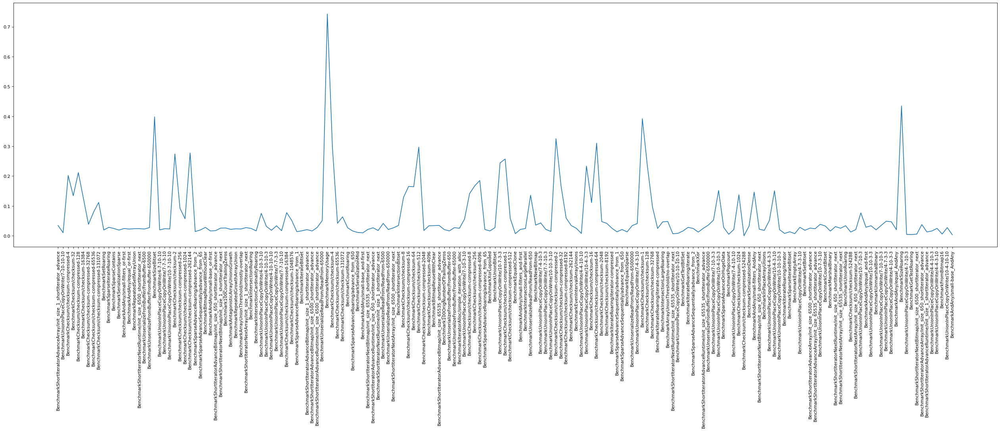

In [34]:
labels=list(measurements.keys())
plt.figure(figsize=(40, 10), dpi=80)
plt.plot(cv)
plt.xticks([x for x in range(len(labels))], labels, rotation='vertical')
plt.show()
#plt.plot(spread)

In [32]:
for idx, val in enumerate(cv):
    if val > 0.3:
        print(f"{labels[idx]}: {val}")

BenchmarkSizeBitset: 0.39856513478560396
BenchmarkMemoryUsage: 0.743070787348916
BenchmarkChecksum/checksum-compressed-2: 0.32536151189338625
BenchmarkChecksum/checksum-compressed-64: 0.310324057088978
BenchmarkChecksum/checksum-1: 0.39223227027636803
BenchmarkSizeRoaring: 0.43514263457633695


In [4]:
def get_name_from_dot(path):
    # Remove last dot, remove last 3 "_" which are hardcoded
    return path.split("/")[-1].rsplit(".", 1)[0].rsplit("_", 3)[0]

def get_name_from_db_bench(name):
    return name.replace("/", "-")

In [5]:
print(get_name_from_dot("05-28-2023_BenchmarkNexts-next__100.000000%_1_1_v1-3-0.dot"))
get_name_from_db_bench("BenchmarkChecksum/checksum-compressed-262144")

'BenchmarkChecksum-checksum-compressed-262144'

# Algorithm test

In [21]:
"""
@param benchmarks: list[dict] => {stabilityMetric1, s1, s3, coveredNodes}
@param graphNodes: list[Nodes] => list of nodes in the graph
return benchmarksStrings: set[str] => set of reduced benchmarks
"""
def reduceSuite(benchmarks: [dict], graphNodes: [str]) -> [str]:
    return

# TODO [] calculate bootstrap confidence interval 
# TODO [] Laabers approach does not focus on memory or input/ output io

